# Rain in Australia
## Predict next-day rain in Australia

#### Dataset source:
https://www.kaggle.com/datasets/jsphyg/weather-dataset-rattle-package

#### Context:
This dataset contains about 10 years of daily weather observations from numerous Australian weather stations.

RainTomorrow is the target variable to predict. It means -- did it rain the next day, Yes or No?
This column is Yes if the rain for that day was 1mm or more.

# Table of contents
1. [Imports & reading dataset ](#1)
2. [Data Description](#2)
3. [Data Analysis](#3)
4. [Data Visualization](#4)

# 1.Imports & reading dataset <a name="1"></a>

In [74]:
import numpy as np
import pandas as pd
import seaborn as sns
sns.set_style('darkgrid')
sns.set_palette('Set2')
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
df = pd.read_csv('https://raw.githubusercontent.com/WeatherForecasterTeam/australia_weather_forecasts/main/data/weatherAUS.csv?token=GHSAT0AAAAAAB4ZSDHJHGXIP2WOQAGQF6SWY5OC4OA')
df.columns = df.columns.str.lower()

In [3]:
df.head()

,date,location,mintemp,maxtemp,rainfall,evaporation,sunshine,windgustdir,windgustspeed,winddir9am,...,humidity9am,humidity3pm,pressure9am,pressure3pm,cloud9am,cloud3pm,temp9am,temp3pm,raintoday,raintomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [40]:
df.tail()

,date,location,mintemp,maxtemp,rainfall,evaporation,sunshine,windgustdir,windgustspeed,winddir9am,...,humidity9am,humidity3pm,pressure9am,pressure3pm,cloud9am,cloud3pm,temp9am,temp3pm,raintoday,raintomorrow
145455,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
145456,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
145457,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
145458,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No
145459,2017-06-25,Uluru,14.9,NaN,0.0,NaN,NaN,NaN,NaN,ESE,...,62.0,36.0,1020.2,1017.9,8.0,8.0,15.0,20.9,No,NaN


In [41]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   date           145460 non-null  object 
 1   location       145460 non-null  object 
 2   mintemp        143975 non-null  float64
 3   maxtemp        144199 non-null  float64
 4   rainfall       142199 non-null  float64
 5   evaporation    82670 non-null   float64
 6   sunshine       75625 non-null   float64
 7   windgustdir    135134 non-null  object 
 8   windgustspeed  135197 non-null  float64
 9   winddir9am     134894 non-null  object 
 10  winddir3pm     141232 non-null  object 
 11  windspeed9am   143693 non-null  float64
 12  windspeed3pm   142398 non-null  float64
 13  humidity9am    142806 non-null  float64
 14  humidity3pm    140953 non-null  float64
 15  pressure9am    130395 non-null  float64
 16  pressure3pm    130432 non-null  float64
 17  cloud9am       89572 non-null

# 2.Data Description<a name="2"></a>

1 - description des variables

><b>Features</b> :
* date : la date de l'observation
* location : l'emplacement géographique.
* mintemp : la température minimale en degrés Celsius.
* maxtemp : la température maximale en degrés Celsius.
* rainfall : la quantité de pluie en millimètres.
* evaporation : l'évaporation en millimètres.
* sunshine : le nombre d'heures de soleil.
* windgustdir : la direction du coup de vent.
* windgustspeed : la vitesse du coup de vent.
* winddir9am : la direction du vent à 9h du matin.
* winddir3pm : la direction du vent à 15h.
* windspeed9am : la vitesse du vent à 9h du matin.
* windspeed3pm : la vitesse du vent à 15h.
* humidity9am : l'humidité à 9h du matin.
* humidity3pm : l'humidité à 15h.
* pressure9am : la pression atmosphérique à 9h du matin.
* pressure3pm : la pression atmosphérique à 15h.
* cloud9am : le couvert nuageux à 9h du matin.
* cloud3pm : le couvert nuageux à 15h.
* temp9am : la température à 9h du matin.
* temp3pm : la température à 15h.
* raintoday : s'il y a eu de la pluie aujourd'hui.

><b>Target</b> :
* raintomorrow : s'il y aura de la pluie demain.

2 - description

In [42]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   date           145460 non-null  object 
 1   location       145460 non-null  object 
 2   mintemp        143975 non-null  float64
 3   maxtemp        144199 non-null  float64
 4   rainfall       142199 non-null  float64
 5   evaporation    82670 non-null   float64
 6   sunshine       75625 non-null   float64
 7   windgustdir    135134 non-null  object 
 8   windgustspeed  135197 non-null  float64
 9   winddir9am     134894 non-null  object 
 10  winddir3pm     141232 non-null  object 
 11  windspeed9am   143693 non-null  float64
 12  windspeed3pm   142398 non-null  float64
 13  humidity9am    142806 non-null  float64
 14  humidity3pm    140953 non-null  float64
 15  pressure9am    130395 non-null  float64
 16  pressure3pm    130432 non-null  float64
 17  cloud9am       89572 non-null

In [ ]:
df.describe()

,mintemp,maxtemp,rainfall,evaporation,sunshine,windgustspeed,windspeed9am,windspeed3pm,humidity9am,humidity3pm,pressure9am,pressure3pm,cloud9am,cloud3pm,temp9am,temp3pm
count,143975.000000,144199.000000,142199.000000,82670.000000,75625.000000,135197.000000,143693.000000,142398.000000,142806.000000,140953.000000,130395.00000,130432.000000,89572.000000,86102.000000,143693.000000,141851.00000
mean,12.194034,23.221348,2.360918,5.468232,7.611178,40.035230,14.043426,18.662657,68.880831,51.539116,1017.64994,1015.255889,4.447461,4.509930,16.990631,21.68339
std,6.398495,7.119049,8.478060,4.193704,3.785483,13.607062,8.915375,8.809800,19.029164,20.795902,7.10653,7.037414,2.887159,2.720357,6.488753,6.93665
min,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.50000,977.100000,0.000000,0.000000,-7.200000,-5.40000
25%,7.600000,17.900000,0.000000,2.600000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.90000,1010.400000,1.000000,2.000000,12.300000,16.60000
50%,12.000000,22.600000,0.000000,4.800000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.60000,1015.200000,5.000000,5.000000,16.700000,21.10000
75%,16.900000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.40000,1020.000000,7.000000,7.000000,21.600000,26.40000
max,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.00000,1039.600000,9.000000,9.000000,40.200000,46.70000


### * Null

In [ ]:
df.isnull().sum()

date                 0
location             0
mintemp           1485
maxtemp           1261
rainfall          3261
evaporation      62790
sunshine         69835
windgustdir      10326
windgustspeed    10263
winddir9am       10566
winddir3pm        4228
windspeed9am      1767
windspeed3pm      3062
humidity9am       2654
humidity3pm       4507
pressure9am      15065
pressure3pm      15028
cloud9am         55888
cloud3pm         59358
temp9am           1767
temp3pm           3609
raintoday         3261
raintomorrow      3267
dtype: int64

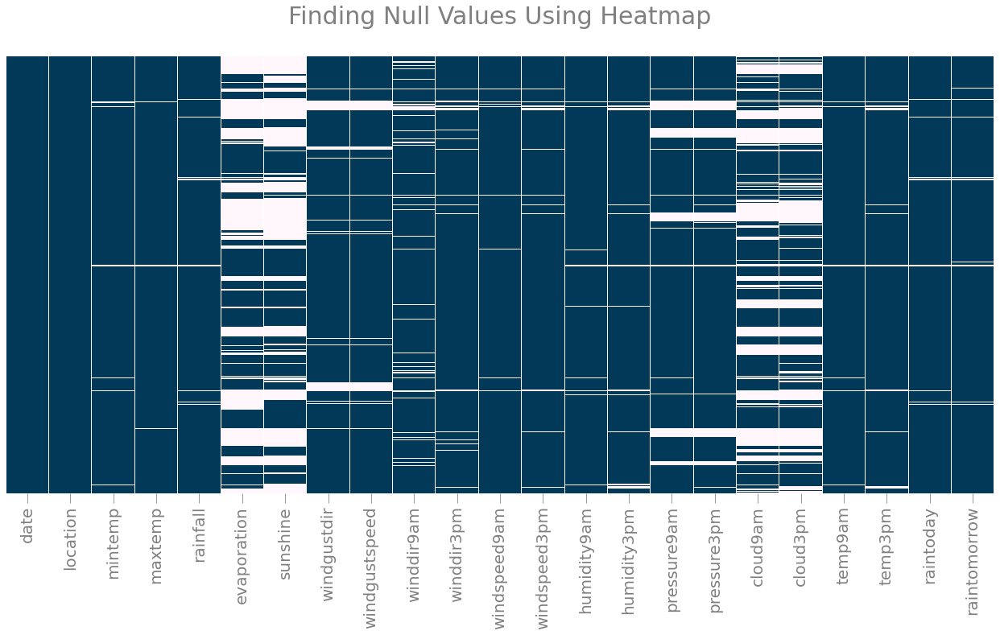

In [43]:
# visualizing null values if it exists
plt.figure(figsize=(22,10))

plt.xticks(size=20,color='grey')
plt.tick_params(size=12,color='grey')

plt.title('Finding Null Values Using Heatmap\n',color='grey',size=30)

sns.heatmap(df.isnull(),
            yticklabels=False,
            cbar=False,
            cmap='PuBu_r',
            );

### * pandas-profiling

In [ ]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

In [ ]:
import pandas_profiling as pp
pp.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
from pandas_profiling import profile_report

import pandas_profiling as pp
pp.ProfileReport(df).to_file("df_weatherAUS_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

# 3.Data Analysis<a name="3"></a>

### 3.Correlation Matrix with Heatmap

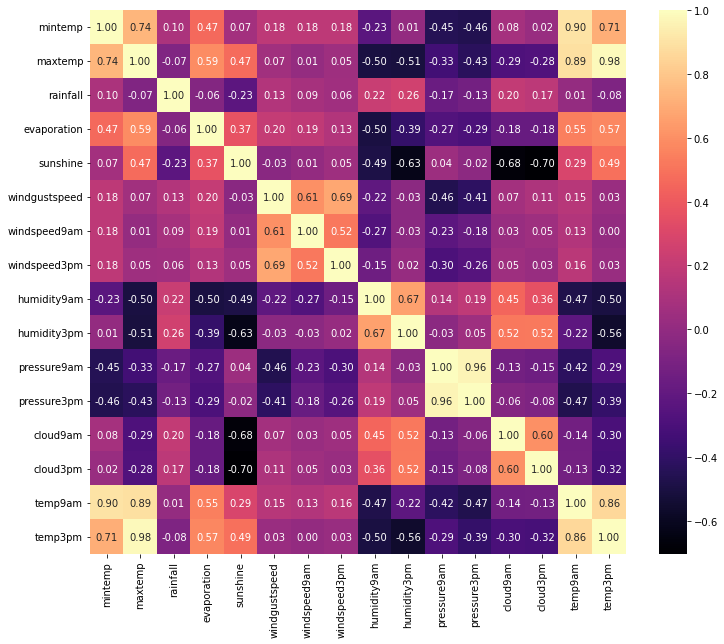

In [44]:
plt.figure(figsize=(12,10))
sns.heatmap(df.corr(),annot=True,cmap="magma",fmt='.2f')

In [ ]:
for i in df.columns:
    print(i,len(df[i].unique()))

date 3436
location 49
mintemp 390
maxtemp 506
rainfall 682
evaporation 359
sunshine 146
windgustdir 17
windgustspeed 68
winddir9am 17
winddir3pm 17
windspeed9am 44
windspeed3pm 45
humidity9am 102
humidity3pm 102
pressure9am 547
pressure3pm 550
cloud9am 11
cloud3pm 11
temp9am 442
temp3pm 503
raintoday 3
raintomorrow 3


# 4.Data Visualizaiton<a name="4"></a>

In [75]:
df2 = df.copy()

In [76]:
df2.columns

Index(['date', 'location', 'mintemp', 'maxtemp', 'rainfall', 'evaporation',
       'sunshine', 'windgustdir', 'windgustspeed', 'winddir9am', 'winddir3pm',
       'windspeed9am', 'windspeed3pm', 'humidity9am', 'humidity3pm',
       'pressure9am', 'pressure3pm', 'cloud9am', 'cloud3pm', 'temp9am',
       'temp3pm', 'raintoday', 'raintomorrow'],
      dtype='object')

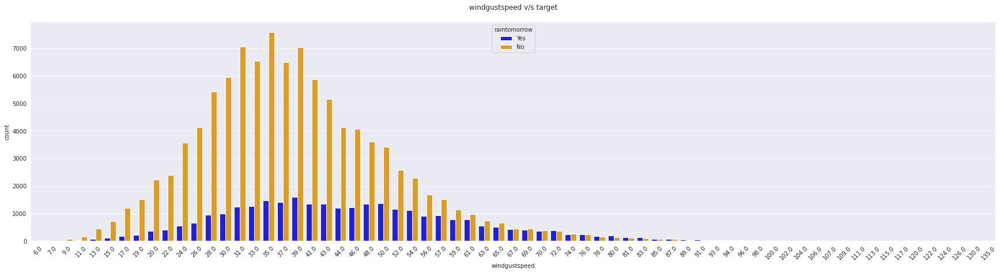

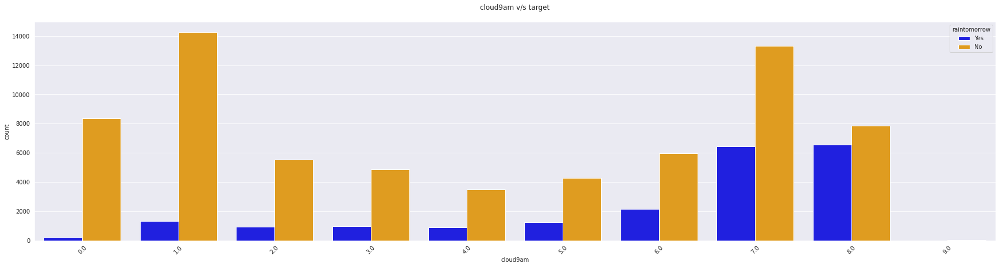

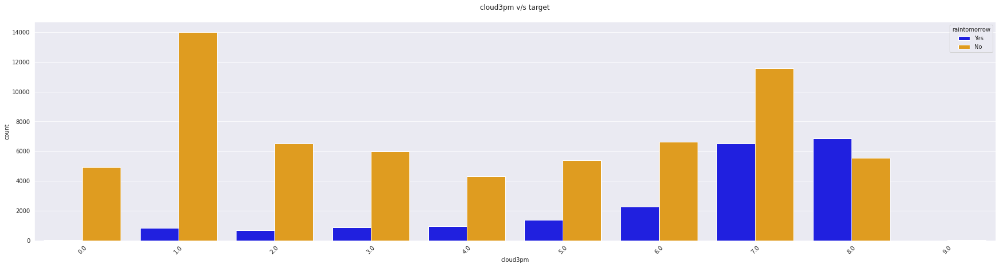

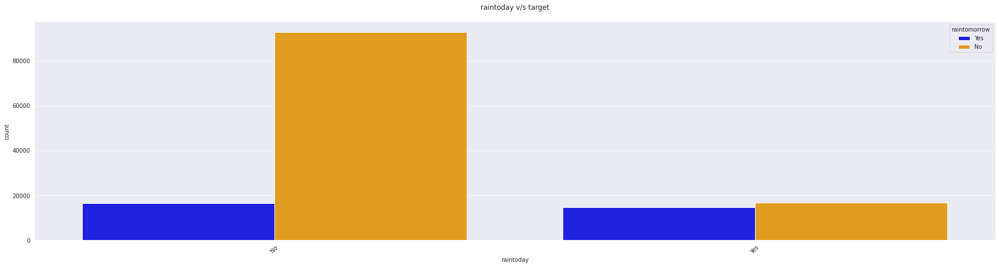

In [77]:
# Import des modules 
import matplotlib.pyplot as plt
import seaborn as sns

# Liste des variables à tracer
variables = ['windgustspeed', 'cloud9am', 'cloud3pm', 'raintoday']

for variable in variables:
    plt.figure(figsize=(30, 7))
    sns.countplot(data=df, x=variable, hue='raintomorrow',hue_order=['Yes', 'No'], palette=['blue', 'orange'])
    plt.title(f'{variable} v/s target\n')
    ax = plt.gca()
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
    plt.show();


## **Pression atmosphérique**

En météorologie, **la pression atmosphérique est un indicateur important pour prévoir le temps qu'il va faire**, car elle peut être utilisée pour mesurer les variations dans l'atmosphère. 


1. Lorsque la pression atmosphérique est élevée, cela signifie que l'atmosphère est stable et que les conditions météorologiques sont généralement calmes et ensoleillées. 

2. Lorsque la pression atmosphérique est faible, cela signifie que l'atmosphère est instable et qu'il y a un risque accru de nuages et de précipitations.


**Lorsque la pression atmosphérique est élevée, cela signifie que l'atmosphère est stable et que les conditions météorologiques sont généralement calmes et ensoleillées.** Cela se produit généralement lorsque l'air est froid et sec et que la pression de l'air au niveau de la mer est élevée. 

**Lorsque la pression atmosphérique est faible, cela signifie que l'atmosphère est instable et qu'il y a un risque accru de nuages et de précipitations**. 
Cela se produit généralement lorsque l'air est chaud et humide et que la pression de l'air au niveau de la mer est faible.

En utilisant ces informations, les météorologues peuvent prévoir avec une certaine précision le temps qu'il va faire dans les jours à venir en observant les variations de la pression atmosphérique et en utilisant d'autres données météorologiques, comme la température, l'humidité et les mouvements des masses d'air.

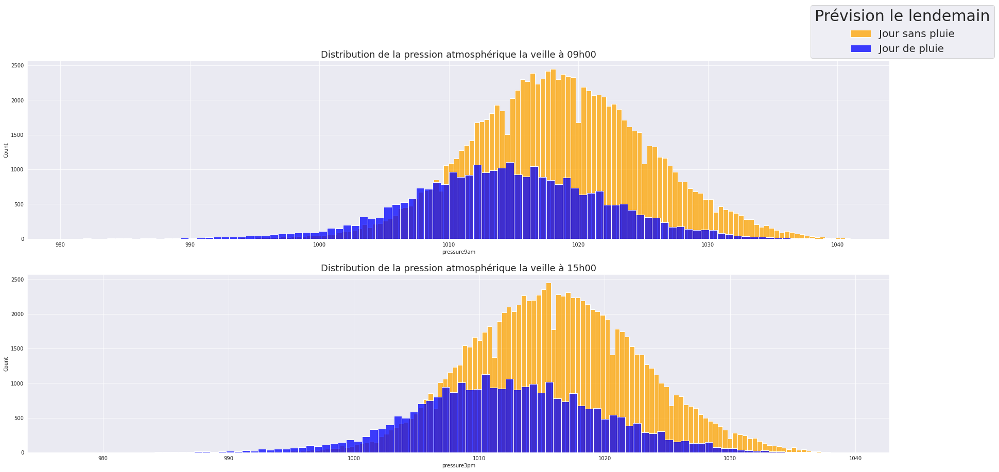

In [78]:
# Figure avec deux subplots
fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(30, 14))

# Histogramme du premier subplot
sns.histplot(data=df[df['raintomorrow']=='No'], x='pressure9am', color='orange', label='Jour sans pluie', ax=ax[0])
sns.histplot(data=df[df['raintomorrow']=='Yes'], x='pressure9am', color='blue', label='Jour de pluie', ax=ax[0])

# Titre du premier subplot
ax[0].set_title("Distribution de la pression atmosphérique la veille à 09h00", fontsize=18)

# Histogramme du deuxième subplot
sns.histplot(data=df[df['raintomorrow']=='No'], x='pressure3pm', color='orange', ax=ax[1])
sns.histplot(data=df[df['raintomorrow']=='Yes'], x='pressure3pm', color='blue', ax=ax[1])

# Titre au deuxième subplot
ax[1].set_title("Distribution de la pression atmosphérique la veille à 15h00", fontsize=18)

# Légende de la figure
fig.legend(title='Prévision le lendemain', fontsize=20, title_fontsize=30)

plt.show()


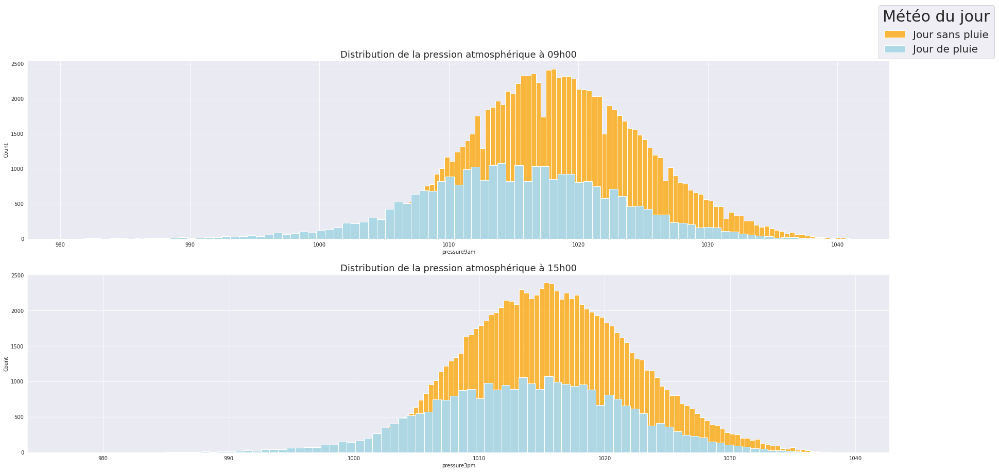

In [79]:
# Figure avec deux subplots
fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(30, 14))

# Histogrammes du premier subplot
sns.histplot(data=df[df['raintoday']=='No'], x='pressure9am', color='orange', label='Jour sans pluie', ax=ax[0])
sns.histplot(data=df[df['raintoday']=='Yes'], x='pressure9am', color='lightblue', alpha=0.99, label='Jour de pluie', ax=ax[0])

# Titre au premier subplot
ax[0].set_title("Distribution de la pression atmosphérique à 09h00", fontsize=18)


# Histogrammes du premier subplot
sns.histplot(data=df[df['raintoday']=='No'], x='pressure3pm', color='orange', ax=ax[1])
sns.histplot(data=df[df['raintoday']=='Yes'], x='pressure3pm', color='lightblue', alpha=0.99, ax=ax[1])

# Titre au deuxième subplot
ax[1].set_title("Distribution de la pression atmosphérique à 15h00", fontsize=18)

# Légende à la figure
fig.legend(title='Météo du jour', fontsize=20, title_fontsize=30)

plt.show()

## **Le vent**

Le vent peut influencer la probabilité de pluie en transportant de l'air humide vers une région, ce qui peut augmenter la probabilité de pluie.
 De même, un vent fort peut aider à disperser les nuages et à réduire la probabilité de pluie

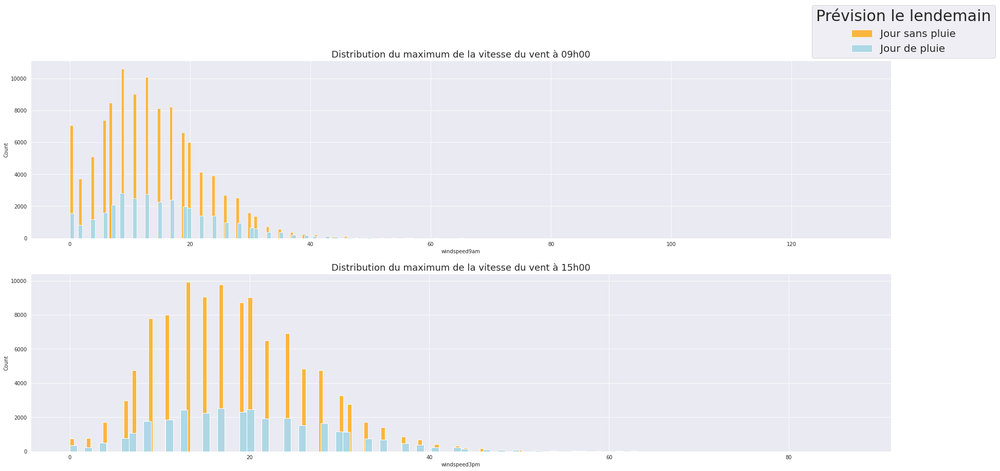

In [80]:
# Figure avec deux subplots
fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(30, 14))

# Histogrammes du premier subplot
sns.histplot(data=df[df['raintomorrow']=='No'], x='windspeed9am', color='orange', label='Jour sans pluie', ax=ax[0])
sns.histplot(data=df[df['raintomorrow']=='Yes'], x='windspeed9am', color='lightblue', alpha=0.99, label='Jour de pluie', ax=ax[0])

# Titre du premier subplot
ax[0].set_title("Distribution du maximum de la vitesse du vent à 09h00", fontsize=18)

# Histogrammes du deuxième subplot
sns.histplot(data=df[df['raintomorrow']=='No'], x='windspeed3pm', color='orange', ax=ax[1])
sns.histplot(data=df[df['raintomorrow']=='Yes'], x='windspeed3pm', color='lightblue', alpha=0.99, ax=ax[1])

# Titre au deuxième subplot
ax[1].set_title("Distribution du maximum de la vitesse du vent à 15h00", fontsize=18)

# Légende à la figure
fig.legend(title='Prévision le lendemain', fontsize=20, title_fontsize=30)

plt.show()

Un windgust est une rafale de vent soudaine et temporaire qui est généralement plus forte que la vitesse du vent moyenne dans une région donnée.

Les windgusts sont généralement causés par des variations de pression atmosphérique ou par des conditions météorologiques changeantes, comme les fronts froids ou les tempêtes.


In [81]:
# Import de plotly
import plotly.graph_objects as go

# Labels pour chaque axe du graphe en mode radar
labels = ['N', 'NNE', 'NE', 'ENE', 'E', 'ESE', 'SE', 'SSE', 'S', 'SSW',
          'SW', 'WSW', 'W', 'WNW', 'NW', 'NNW']

# Sélection des données pour les jours avec pluie
df_rain = df[df['raintomorrow']=='Yes']

# Liste de données pour le graphe en mode radar
data = df_rain['winddir3pm'].value_counts()

# instantiation d'un objet Figure
fig = go.Figure()

# Ajout des données pour chaque jour avec pluie au graphe en mode radar
fig.add_trace(go.Scatterpolar(
      r=data,
      theta=labels,
      fill='toself',
      name='Jour avec pluie',
      marker=dict(color='blue')
))

# Ajustement l'échelle des axes du graphe en mode radar
fig.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=True,
      range=[0, max(data)]
    )),
  showlegend=True,
  title="Prévision de pluie le lendemain en fonction de la direction du vent la veille à 15h00"
)

# Affichage du graphe
fig.show(width=1800, height=1600)

# Sélection des données pour les jours sans pluie
df_no_rain = df[df['raintomorrow']=='No']

# Création d'une liste de données pour le graphe en mode radar
data = df_no_rain['winddir3pm'].value_counts()

# Création d'un objet Figure
fig = go.Figure()

# Ajout des données pour chaque jour sans pluie au graphe en mode radar
fig.add_trace(go.Scatterpolar(
      r=data,
      theta=labels,
      fill='toself',
      name='Jour sans pluie',
      marker=dict(color='orange')
))

# Ajustement de l'échelle des axes du graphe en mode radar
fig.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=True,
      range=[0, max(data)]
    )),
  showlegend=True,
  title="Prévision du temps sec le lendemain en fonction de la direction du vent la veille à 15h00"
)
# Affichage du graphe
fig.show(width=1800, height=1600)


In [82]:
# Import de plotly
import plotly.graph_objects as go

# Labels pour chaque axe du graphe en mode radar
labels = ['N', 'NNE', 'NE', 'ENE', 'E', 'ESE', 'SE', 'SSE', 'S', 'SSW',
          'SW', 'WSW', 'W', 'WNW', 'NW', 'NNW']

# Sélection des données pour les jours avec pluie
df_rain = df[df['raintomorrow']=='Yes']

# Liste de données pour le graphe en mode radar
data = df_rain['winddir9am'].value_counts()

# instantiation d'un objet Figure
fig = go.Figure()

# Ajout des données pour chaque jour avec pluie au graphe en mode radar
fig.add_trace(go.Scatterpolar(
      r=data,
      theta=labels,
      fill='toself',
      name='Jour avec pluie',
      marker=dict(color='blue')
))

# Ajustement l'échelle des axes du graphe en mode radar
fig.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=True,
      range=[0, max(data)]
    )),
  showlegend=True,
  title="Prévision de pluie le lendemain en fonction de la direction du vent la veille à 09h00"
)

# Affichage du graphe
fig.show(width=1800, height=1600)

# Sélection des données pour les jours sans pluie
df_no_rain = df[df['raintomorrow']=='No']

# Création d'une liste de données pour le graphe en mode radar
data = df_no_rain['winddir9am'].value_counts()

# Création d'un objet Figure
fig = go.Figure()

# Ajout des données pour chaque jour sans pluie au graphe en mode radar
fig.add_trace(go.Scatterpolar(
      r=data,
      theta=labels,
      fill='toself',
      name='Jour sans pluie',
      marker=dict(color='orange')
))

# Ajustement de l'échelle des axes du graphe en mode radar
fig.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=True,
      range=[0, max(data)]
    )),
  showlegend=True,
  title="Prévision du temps sec le lendemain en fonction de la direction du vent la veille à 09h00"
)
# Affichage du graphe
fig.show(width=1800, height=1600)


In [62]:
# Import de plotly
import plotly.graph_objects as go

# Labels pour chaque axe du graphe en mode radar
labels = ['N', 'NNE', 'NE', 'ENE', 'E', 'ESE', 'SE', 'SSE', 'S', 'SSW',
          'SW', 'WSW', 'W', 'WNW', 'NW', 'NNW']

# Sélection des données pour les jours avec pluie
df_rain = df[df['raintomorrow']=='Yes']

# Liste de données pour le graphe en mode radar
data = df_rain['windgustdir'].value_counts()

# instantiation d'un objet Figure
fig = go.Figure()

# Ajout des données pour chaque jour avec pluie au graphe en mode radar
fig.add_trace(go.Scatterpolar(
      r=data,
      theta=labels,
      fill='toself',
      name='Jour avec pluie',
      marker=dict(color='blue')
))

# Ajustement l'échelle des axes du graphe en mode radar
fig.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=True,
      range=[0, max(data)]
    )),
  showlegend=True,
  title="Prévision de pluie le lendemain en fonction de la direction de la rafale la veille à 09h00"
)

# Affichage du graphe
fig.show(width=1800, height=1600)

# Sélection des données pour les jours sans pluie
df_no_rain = df[df['raintomorrow']=='No']

# Création d'une liste de données pour le graphe en mode radar
data = df_no_rain['windgustdir'].value_counts()

# Création d'un objet Figure
fig = go.Figure()

# Ajout des données pour chaque jour sans pluie au graphe en mode radar
fig.add_trace(go.Scatterpolar(
      r=data,
      theta=labels,
      fill='toself',
      name='Jour sans pluie',
      marker=dict(color='orange')
))

# Ajustement de l'échelle des axes du graphe en mode radar
fig.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=True,
      range=[0, max(data)]
    )),
  showlegend=True,
  title="Prévision du temps sec le lendemain en fonction de la direction de la rafale la veille à 09h00"
)
# Affichage du graphe
fig.show(width=1800, height=1600)


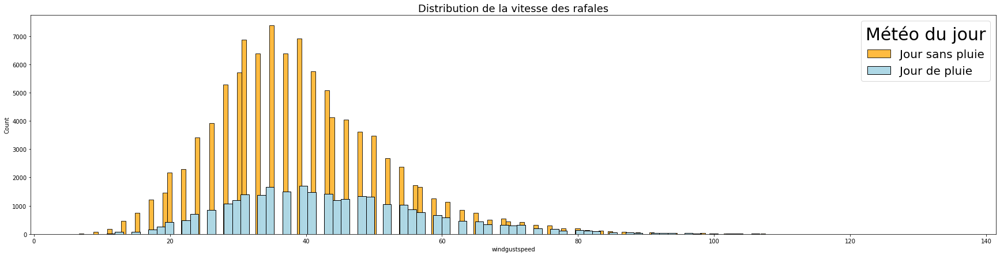

In [73]:
# Créez une figure
fig, ax = plt.subplots(figsize=(30, 7))

# Utilisez la fonction histplot pour tracer l'histogramme
sns.histplot(data=df[df['raintoday']=='No'], x='windgustspeed', color='orange', label='Jour sans pluie', ax=ax)
sns.histplot(data=df[df['raintoday']=='Yes'], x='windgustspeed', color='lightblue', alpha=0.99, label='Jour de pluie', ax=ax)

# Ajoutez un titre au graphique
ax.set_title("Distribution de la vitesse des rafales", fontsize=18)

# Ajoutez une légende au graphique
ax.legend(title='Météo du jour', fontsize=20, title_fontsize=30)

plt.show()





## **La température**

La température peut être un indicateur de la probabilité de pluie car elle peut influencer la quantité de vapeur d'eau présente dans l'air. Si la température est élevée, il y a plus de vapeur d'eau dans l'air, ce qui peut augmenter la probabilité de pluie.

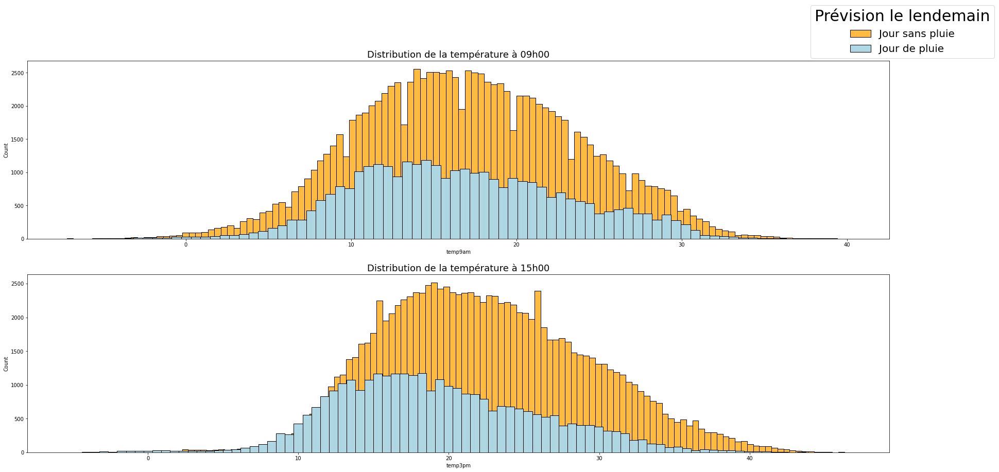

In [50]:
# Figure avec deux subplots
fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(30, 14))

# Histogrammes du premier subplot
sns.histplot(data=df[df['raintomorrow']=='No'], x='temp9am', color='orange', label='Jour sans pluie', ax=ax[0])
sns.histplot(data=df[df['raintomorrow']=='Yes'], x='temp9am', color='lightblue', alpha=0.99, label='Jour de pluie', ax=ax[0])

# Titre du premier subplot
ax[0].set_title("Distribution de la température à 09h00", fontsize=18)

# Histogrammes du premier subplot
sns.histplot(data=df[df['raintomorrow']=='No'], x='temp3pm', color='orange', ax=ax[1])
sns.histplot(data=df[df['raintomorrow']=='Yes'], x='temp3pm', color='lightblue', alpha=0.99, ax=ax[1])

# Titre du deuxième subplot
ax[1].set_title("Distribution de la température à 15h00", fontsize=18)

# Légende de la figure
fig.legend(title='Prévision le lendemain', fontsize=20, title_fontsize=30)

plt.show()


## **L'humidité**

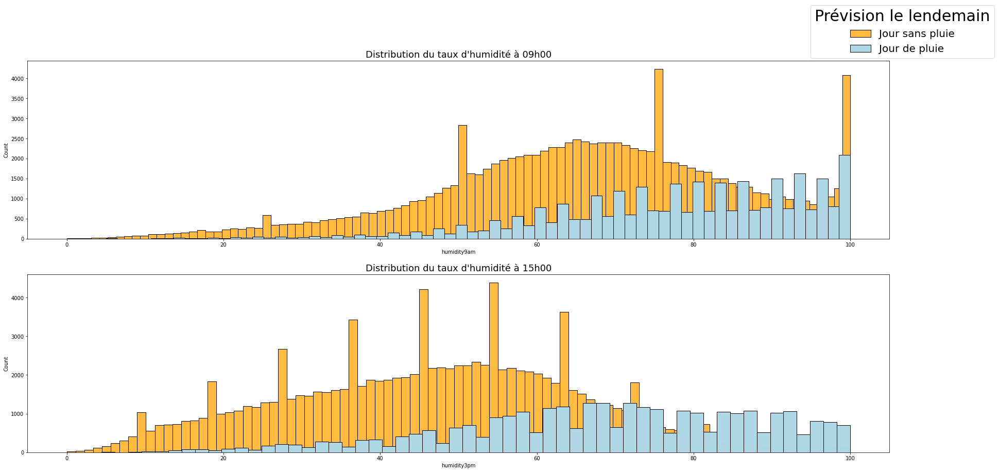

In [51]:
# Figure avec deux subplots
fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(30, 14))

# Histogrammes du premier subplot
sns.histplot(data=df[df['raintomorrow']=='No'], x='humidity9am', color='orange', label='Jour sans pluie', ax=ax[0])
sns.histplot(data=df[df['raintomorrow']=='Yes'], x='humidity9am', color='lightblue', alpha=0.99, label='Jour de pluie', ax=ax[0])

# Titre du premier subplot
ax[0].set_title("Distribution du taux d'humidité à 09h00", fontsize=18)

# Histogrammes du deuxième subplot
sns.histplot(data=df[df['raintomorrow']=='No'], x='humidity3pm', color='orange', ax=ax[1])
sns.histplot(data=df[df['raintomorrow']=='Yes'], x='humidity3pm', color='lightblue', alpha=0.99, ax=ax[1])

# Titre du deuxième subplot
ax[1].set_title("Distribution du taux d'humidité à 15h00", fontsize=18)

# Légende de la figure
fig.legend(title='Prévision le lendemain', fontsize=20, title_fontsize=30)

plt.show()


#### 3.Jointplot

In [84]:
df.columns

Index(['date', 'location', 'mintemp', 'maxtemp', 'rainfall', 'evaporation',
       'sunshine', 'windgustdir', 'windgustspeed', 'winddir9am', 'winddir3pm',
       'windspeed9am', 'windspeed3pm', 'humidity9am', 'humidity3pm',
       'pressure9am', 'pressure3pm', 'cloud9am', 'cloud3pm', 'temp9am',
       'temp3pm', 'raintoday', 'raintomorrow'],
      dtype='object')

In [85]:
df3 = df[df['raintomorrow'] == 'Yes' ][['mintemp', 'maxtemp', 'rainfall', 'evaporation',
       'sunshine', 'windgustdir', 'windgustspeed', 'winddir9am', 'winddir3pm',
       'windspeed9am', 'windspeed3pm', 'humidity9am', 'humidity3pm',
       'pressure9am', 'pressure3pm', 'cloud9am', 'cloud3pm', 'temp9am',
       'temp3pm']] #target Yes - Raintomorrow ok

### Le vent peut influencer la probabilité de pluie en transportant de l'air humide vers une région, ce qui peut augmenter la probabilité de pluie : analyse de leurs influences mutuelles

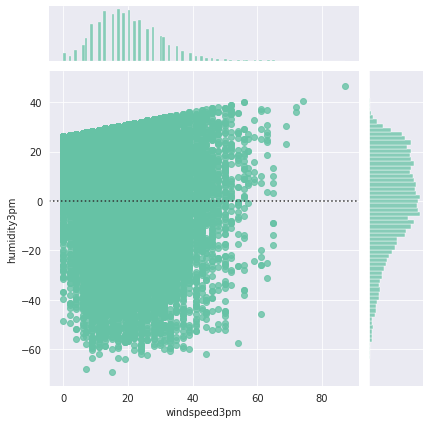

In [103]:
# pression vs évaporation
sns.jointplot(data=df3,
              x='windspeed3pm',
              y='humidity3pm', 
              kind='resid'
              )

## Influence de l'évaporation sur la prévision de pluie 
L'évaporation est un processus naturel qui se produit lorsque l'eau passe de l'état liquide à l'état gazeux. Elle peut jouer un rôle important dans la prévision de la pluie car elle peut influencer la quantité de vapeur d'eau présente dans l'air et, par conséquent, la probabilité de pluie.

Lorsque l'eau s'évapore, elle emporte de l'énergie avec elle, ce qui peut refroidir l'air environnant. Si l'air est assez froid, la vapeur d'eau peut se condenser et former des nuages, ce qui peut entraîner de la pluie. Si l'air est chaud et sec, l'évaporation peut réduire la quantité d'eau dans l'air et réduire la probabilité de pluie.

Il est important de noter que l'évaporation est influencée par de nombreux facteurs, tels que la température, le taux d'humidité, le vent et la pression atmosphérique. Par conséquent, il est difficile de prévoir exactement comment l'évaporation va affecter la probabilité de pluie à un moment donné. Cependant, en prenant en compte ces facteurs et en utilisant des données météorologiques fiables, il est possible de prévoir approximativement comment l'évaporation va influencer la probabilité de pluie dans une région donnée.

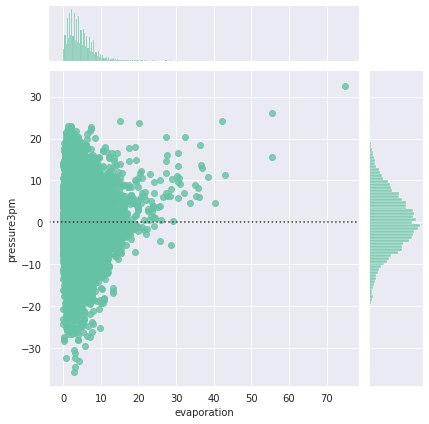

In [102]:
# pression vs évaporation
sns.jointplot(data=df3,
              x='evaporation',
              y='pressure3pm', 
              kind='resid'
              )


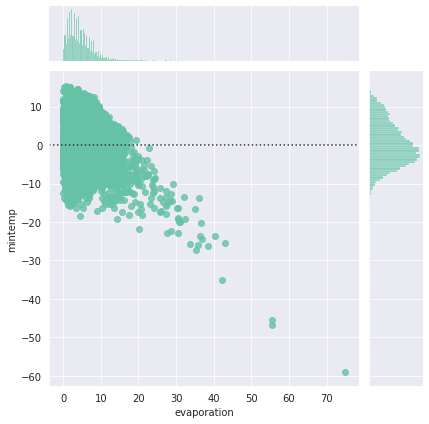

In [104]:
# pression vs évaporation
sns.jointplot(data=df3,
              x='evaporation',
              y='mintemp', 
              kind='resid'
              )


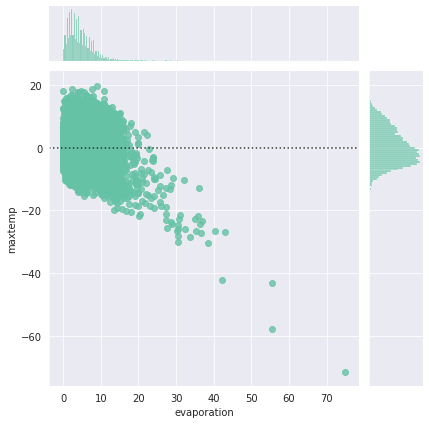

In [105]:
# pression vs évaporation
sns.jointplot(data=df3,
              x='evaporation',
              y='maxtemp', 
              kind='resid'
              )

####  4.Boxplot / violinplot

<AxesSubplot: xlabel='raintomorrow', ylabel='pressure3pm'>

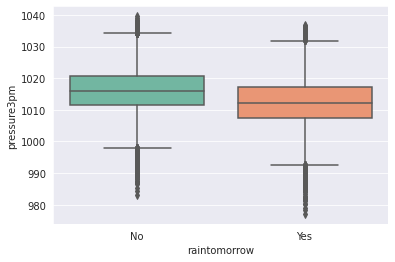

In [106]:
sns.boxplot(data=df2,x='raintomorrow',y='pressure3pm')

<AxesSubplot: xlabel='winddir3pm', ylabel='pressure3pm'>

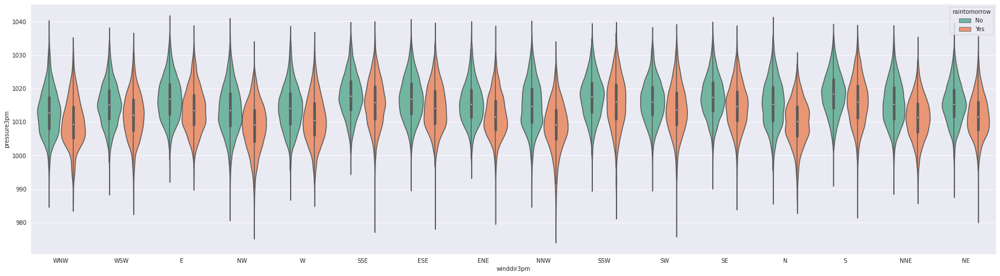

In [109]:
plt.figure(figsize=(30,8)) 
sns.violinplot(data=df2,x='winddir3pm',y='pressure3pm',hue='raintomorrow')

<AxesSubplot: xlabel='winddir3pm', ylabel='pressure3pm'>

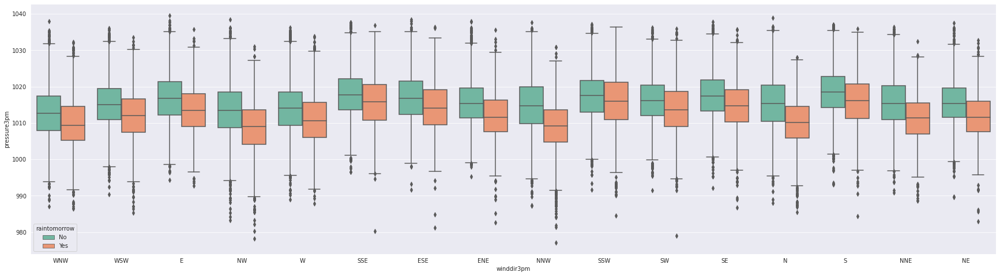

In [111]:
plt.figure(figsize=(30,8)) 
sns.boxplot(data=df2,x='winddir3pm',y='pressure3pm',hue='raintomorrow')

####5.Cluster Map

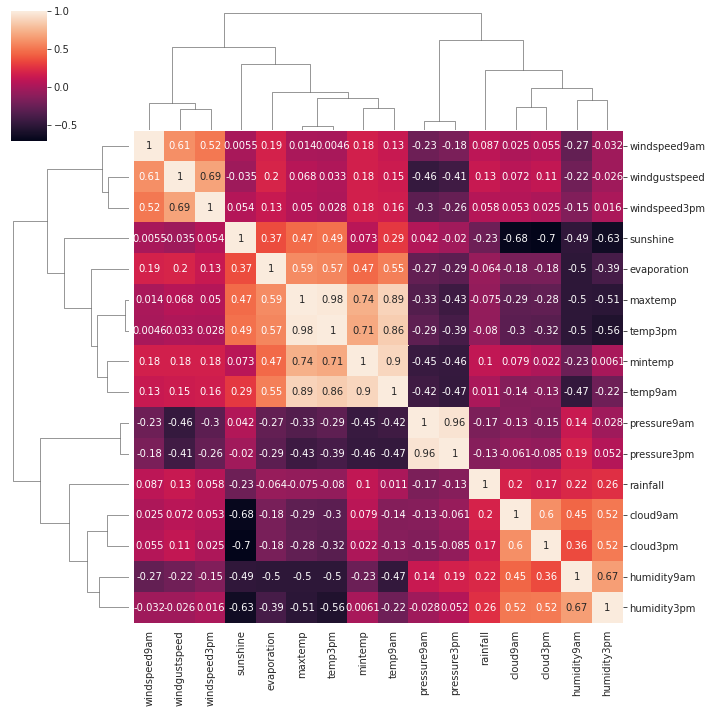

In [ ]:
sns.clustermap(df.corr(),annot=True)

####5.Pairplot

In [100]:
sns.pairplot(df,hue='raintomorrow')

KeyboardInterrupt: ignored

Error in callback <function flush_figures at 0x7fd2333ea0d0> (for post_execute):


KeyboardInterrupt: ignored